In [2]:
import os
import requests
import csv
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# For nice Plots
%matplotlib inline
plt.style.use('default')
plt.rcParams["figure.figsize"] = (20,8)

In [3]:
IDs = [28479,	28480,	28482,	28483,	28486,	28487,	28488,	28489,	28490,	28491,	28492,	28493,	28494,	28495,	28496,	28498,	28499,	28509,	28510,	28511,	28512,	28514,	28515,	28516,	28517,	28519,	28520,	28522,	28533,	28565,	28602,	28603,	28606,	28607,	28608,	28609,	28610,	28613,	28614,	28615,	28616,	28617,	28618,	28620,	28621,	28625,	28640,	28641,	38806]
Countries = ['Cotr d lvoire','Ghana','Liberia','Morocco','Western Saraha', 'Burkina Faso', 'Guinea', 'Guinea-Bissau', 'Mali', 'Mauritania', 'Senegal', 'Sierra Leone', 'Djibouti', 'Eritrea', 'Ethiopia',  'Sudan', 'Uganda', 'Algeria', 'Cameroon', 'Central African Republic', 'Libya', 'Tunisia', 'Benin', 'Chad', 'Equatorial Guinea', 'Niger', 'Nigeria', 'Togo', 'Egypt', 'Somalia', 'Botswana', 'Burundi', 'Kenya', 'Rwanda', 'Tanzania', 'Zambia', 'Zimbabwe', 'Lesotho', 'Malawi', 'Mozambique', 'South Africa', 'Swaziland', 'Angola', 'Gabon', 'Namibia', 'Madagascar', 'Congo, Democratic Republic of the', 'Congo, Republic of the', 'South Sudan']

In [141]:
# Get data from NASA-USDA GIMMS Global Agricultural Monitoring (GLAM) system
# https://glam1.gsfc.nasa.gov/
# Data is collected by the MODIS (Moderate Resolution Imaging Spectroradiometer) sensors on the Terra and Aqua satellites
# https://modis.gsfc.nasa.gov/
# Each data value is the mean of all NDVI values for a given 8-day span from images over the given country
# NDVI is a measure of vegetation health, with values between 0 (no veg) and 1 (healthy veg)
# https://en.wikipedia.org/wiki/Normalized_difference_vegetation_index

for id,country in zip(IDs,Countries):
  
  request_str = ('https://glam1.gsfc.nasa.gov/api/gettbl/v4?'+
    'sat=MOD&'+
    'version=v11&'+
    'layer=NDVI&'+
    'mask=MOD44W_2009_land&'+
    'shape=ADM&'+
    'ids='+str(id)+'&'+
    'ts_type=seasonal&'+
    'years=2001&years=2002&years=2003&years=2004&years=2005&'+
    'years=2006&years=2007&years=2008&years=2009&years=2010&'+
    'years=2011&years=2012&years=2013&years=2014&years=2015&'+
    'years=2016&years=2017&years=2018&years=2019&years=2020&'+
    'years=2021&years=2022&years=2023&'+
    'start_month=1&'+
    'num_months=12&'+
    'format=csv')

  r = requests.get(request_str)
  print(r)
  print(str(id)+' '+country)

  file1 = open('data_'+country+'_'+str(id)+'.csv','w')
  file1.write(r.content.decode('UTF-8'))
  file1.close() 


<Response [200]>
28479 Cotr d lvoire
<Response [200]>
28480 Ghana
<Response [200]>
28482 Liberia
<Response [200]>
28483 Morocco
<Response [200]>
28486 Western Saraha
<Response [200]>
28487 Burkina Faso
<Response [200]>
28488 Guinea
<Response [200]>
28489 Guinea-Bissau
<Response [200]>
28490 Mali
<Response [200]>
28491 Mauritania
<Response [200]>
28492 Senegal
<Response [200]>
28493 Sierra Leone
<Response [200]>
28494 Djibouti
<Response [200]>
28495 Eritrea
<Response [200]>
28496 Ethiopia
<Response [200]>
28498 Sudan
<Response [200]>
28499 Uganda
<Response [200]>
28509 Algeria
<Response [200]>
28510 Cameroon
<Response [200]>
28511 Central African Republic
<Response [200]>
28512 Libya
<Response [200]>
28514 Tunisia
<Response [200]>
28515 Benin
<Response [200]>
28516 Chad
<Response [200]>
28517 Equatorial Guinea
<Response [200]>
28519 Niger
<Response [200]>
28520 Nigeria
<Response [200]>
28522 Togo
<Response [200]>
28533 Egypt
<Response [200]>
28565 Somalia
<Response [200]>
28602 Botswana

C:\Users\wb8by\AppData\Local\Temp/ipykernel_1604/3960008910.py:37: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


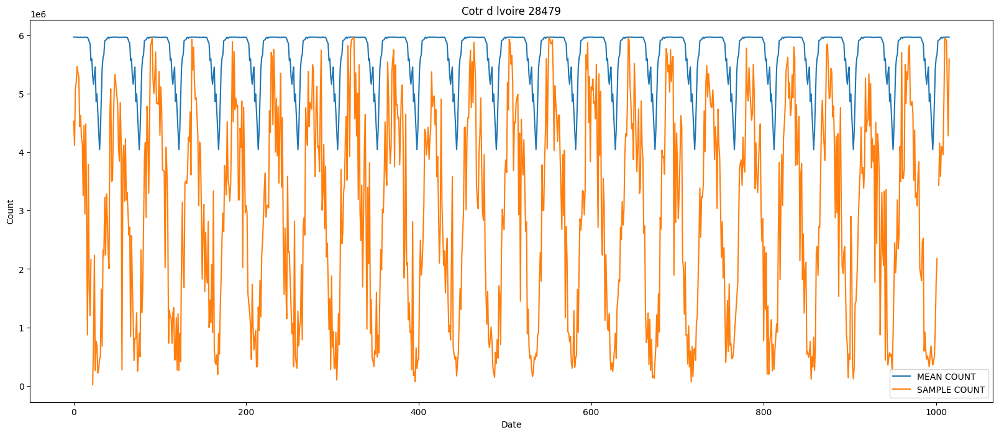

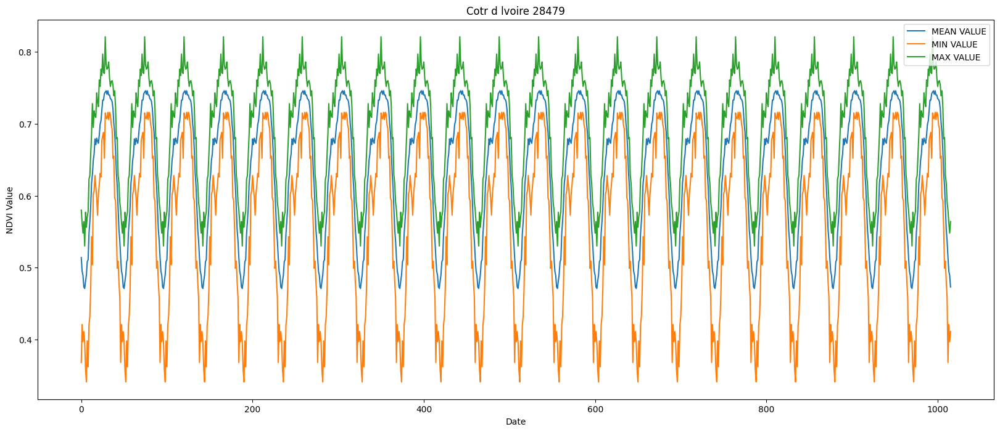

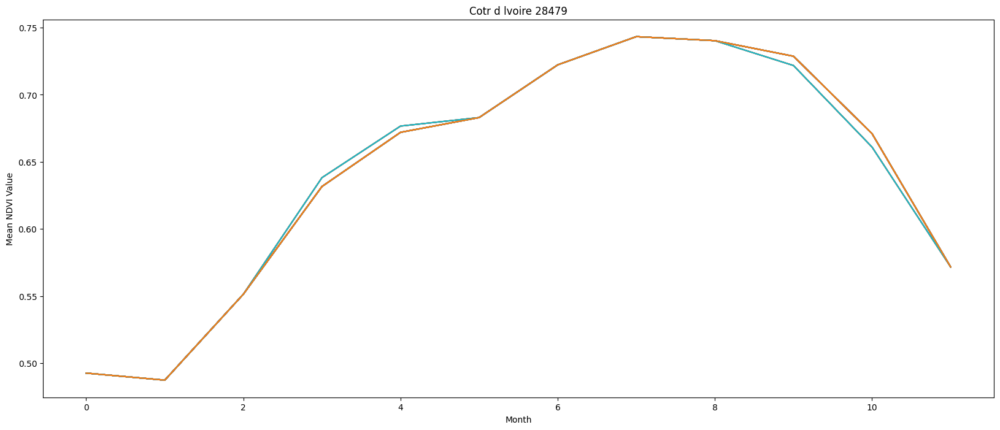

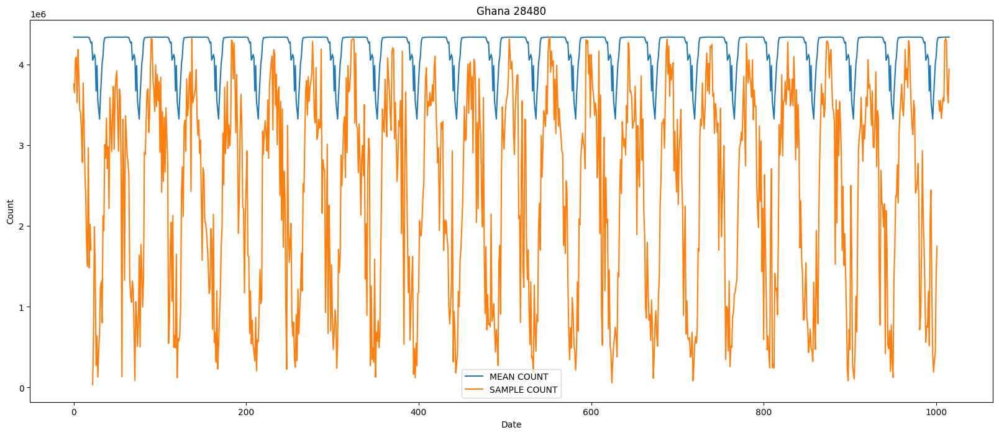

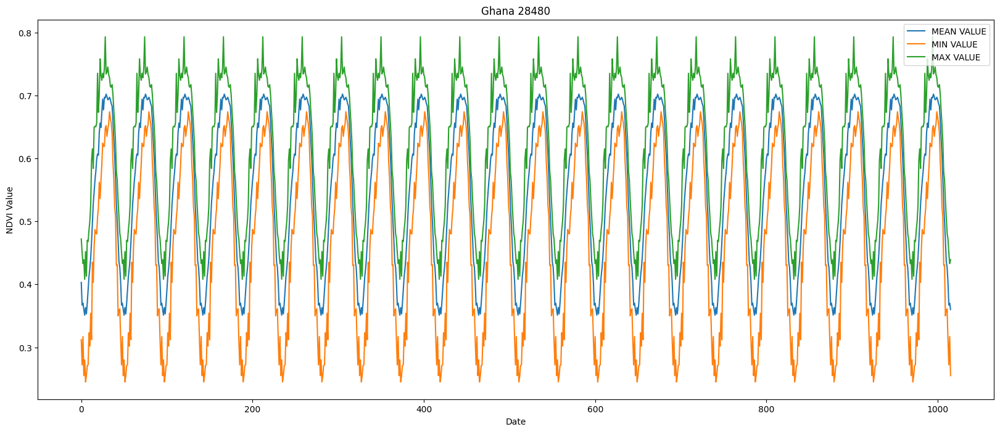

...

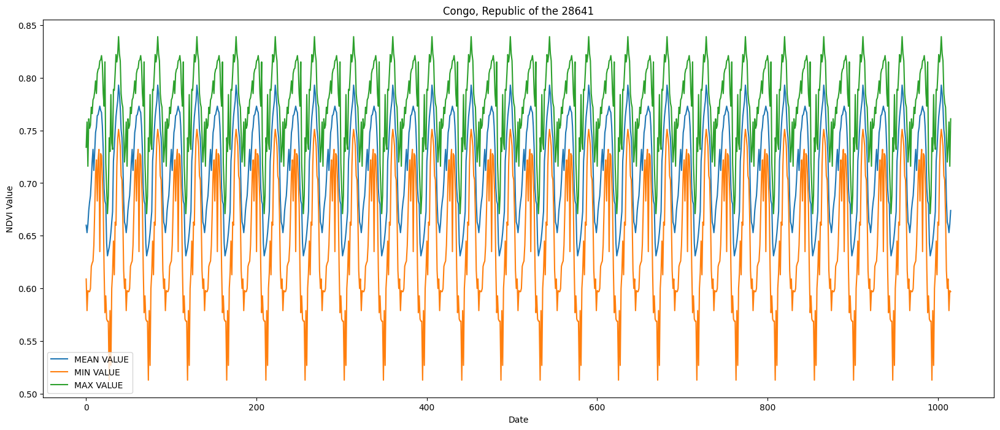

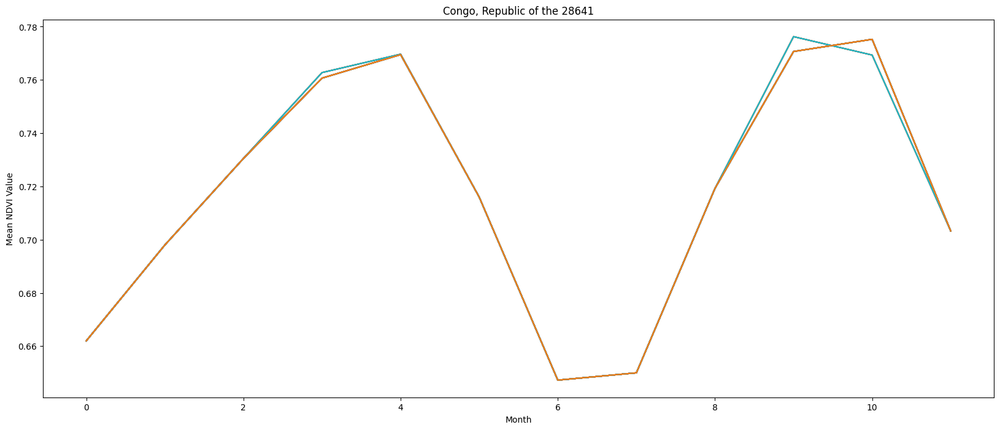

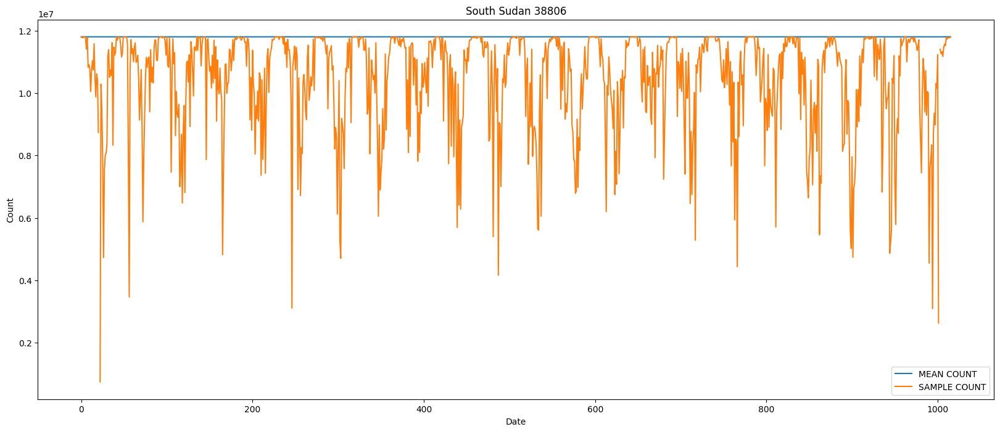

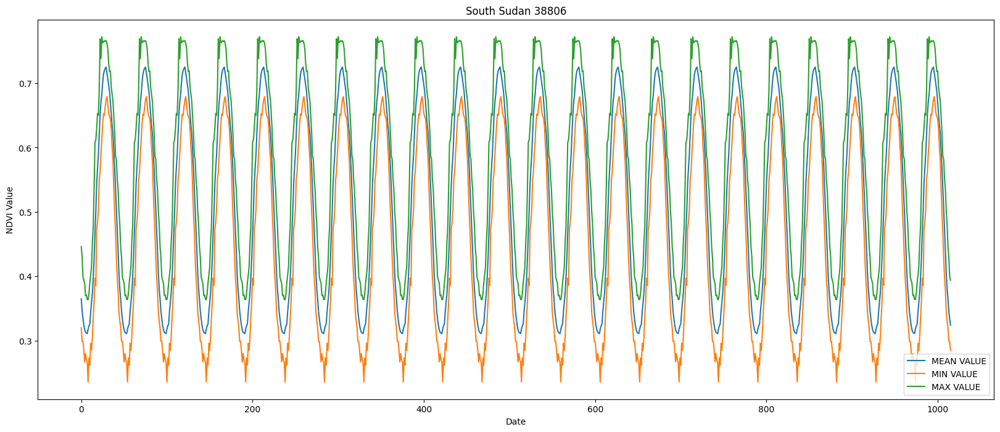

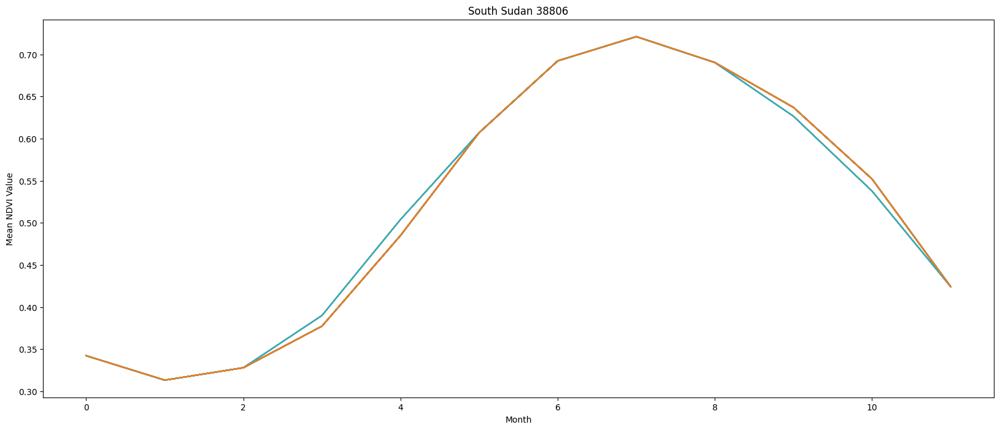

In [7]:
df_all = pd.DataFrame(columns=['Country', 'Year', 'Jan-NDVI', 'Feb-NDVI', 'Mar-NDVI', 'Apr-NDVI', 'May-NDVI', 'Jun-NDVI', 'Jul-NDVI', 'Aug-NDVI', 'Sep-NDVI', 'Oct-NDVI', 'Nov-NDVI', 'Dec-NDVI'])

for id,country in zip(IDs,Countries):

    fname = 'data_'+country+'_'+str(id)+'.csv'
    df = pd.read_csv(fname, skiprows = 13)

    # Put the data in a numpy array indexed by year-2001 by month-1
    plots = np.zeros((23,12))
    num = 0
    year = int(df['START DATE'][0][0:4])
    month = int(df['START DATE'][0][6:7])
    for ind in df.index:
        if month != int(df['START DATE'][ind][5:7]):
            plots[year-2001,month-1] = plots[year-2001,month-1]/num
            num = 0
        if year != int(df['START DATE'][ind][0:4]):
            df_row = [country, year, plots[year-2001,0], plots[year-2001,1], plots[year-2001,2], plots[year-2001,3], plots[year-2001,4], plots[year-2001,5], plots[year-2001,6], plots[year-2001,7], plots[year-2001,8], plots[year-2001,9], plots[year-2001,10], plots[year-2001,11]]
            df_all.loc[len(df_all.index)] = df_row
        year = int(df['START DATE'][ind][0:4])
        month = int(df['START DATE'][ind][5:7])
        plots[year-2001,month-1] = plots[year-2001,month-1] + df['MEAN VALUE'][ind]
        num = num + 1

    df[['MEAN COUNT','SAMPLE COUNT']].plot();
    plt.title(country+' '+str(id));
    plt.xlabel('Date');
    plt.ylabel('Count');
    plt.savefig('Plot_Annual_Count_'+country+'.png')

    df[['MEAN VALUE','MIN VALUE','MAX VALUE']].plot();
    plt.title(country+' '+str(id));
    plt.xlabel('Date');
    plt.ylabel('NDVI Value');
    plt.savefig('Plot_Annual_NDVI_'+country+'.png')

    plt.figure()
    plt.plot(plots[0:22,:].T)
    plt.title(country+' '+str(id));
    plt.xlabel('Month');
    plt.ylabel('Mean NDVI Value');
    plt.savefig('Plot_Seasonal_NDVI_'+country+'.png')

In [5]:
df_all.head()

,Country,Year,Jan-NDVI,Feb-NDVI,Mar-NDVI,Apr-NDVI,May-NDVI,Jun-NDVI,Jul-NDVI,Aug-NDVI,Sep-NDVI,Oct-NDVI,Nov-NDVI,Dec-NDVI
0,Cotr d lvoire,2001,0.49275,0.4875,0.5515,0.631667,0.672000,0.683,0.72225,0.74325,0.74025,0.728667,0.671,0.57175
1,Cotr d lvoire,2002,0.49275,0.4875,0.5515,0.631667,0.672000,0.683,0.72225,0.74325,0.74025,0.728667,0.671,0.57175
2,Cotr d lvoire,2003,0.49275,0.4875,0.5515,0.631667,0.672000,0.683,0.72225,0.74325,0.74025,0.728667,0.671,0.57175
3,Cotr d lvoire,2004,0.49275,0.4875,0.5515,0.638250,0.676667,0.683,0.72225,0.74325,0.74025,0.721750,0.661,0.57175
4,Cotr d lvoire,2005,0.49275,0.4875,0.5515,0.631667,0.672000,0.683,0.72225,0.74325,0.74025,0.728667,0.671,0.57175


In [6]:
df_all.to_csv('ndvi_data.csv', index=False)